In [7]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import pandas as pd
import numpy as np

import torch
import torch.nn as nn
import torch.nn.functional as F

import stockstats

import skimage

import os

In [2]:
margin = dict(l=50, r=50, b=50, t=50)
width = 600
height = 400
window = 80
factor = 20
color = '100,110,250'

In [3]:
def plot_and_save(name, y, x='Step'):
    temp = pd.read_csv(f'{name}.csv')
    step = temp['Step'].tolist()
    step_rev = step[::-1]
    value = temp['Value'].rolling(window, min_periods=1).mean().tolist()
    upper = temp['Value'].rolling(window//factor, min_periods=1).mean().rolling(window, min_periods=1).max().rolling(window, min_periods=1).mean().tolist()
    lower = temp['Value'].rolling(window//factor, min_periods=1).mean().rolling(window, min_periods=1).min().rolling(window, min_periods=1).mean().tolist()[::-1]
    
    fig = go.Figure()
    fig.add_trace(go.Scatter(
        x=step+step_rev,
        y=upper+lower,
        fill='toself',
        fillcolor=f'rgba({color},0.2)',
        line_color='rgba(255,255,255,0)',
        showlegend=False
    ))
    fig.add_trace(go.Scatter(
        x=step, y=value,
        line_color=f'rgb({color})',
        showlegend=False
    ))
    fig.update_layout(xaxis_title=x, yaxis_title=y, margin=margin, width=width, height=height)
    fig.show()
    fig.write_image(f'img/{name}.pdf')

# S1 Training

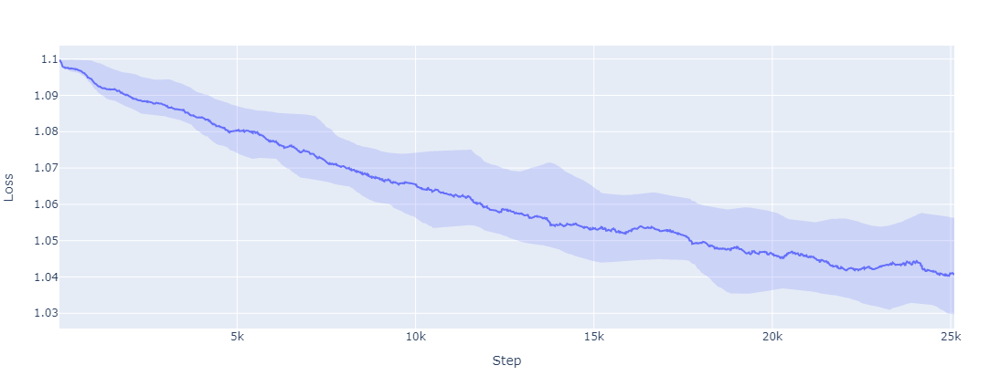

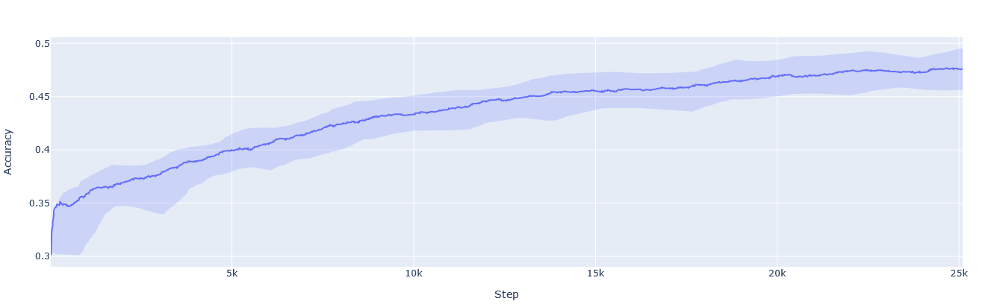

In [4]:
names = ['train_data/s1_train_loss', 'train_data/s1_train_accr']
ys = ['Loss', 'Accuracy']
for name, y in zip(names, ys):
    plot_and_save(name, y)

# S2 Training

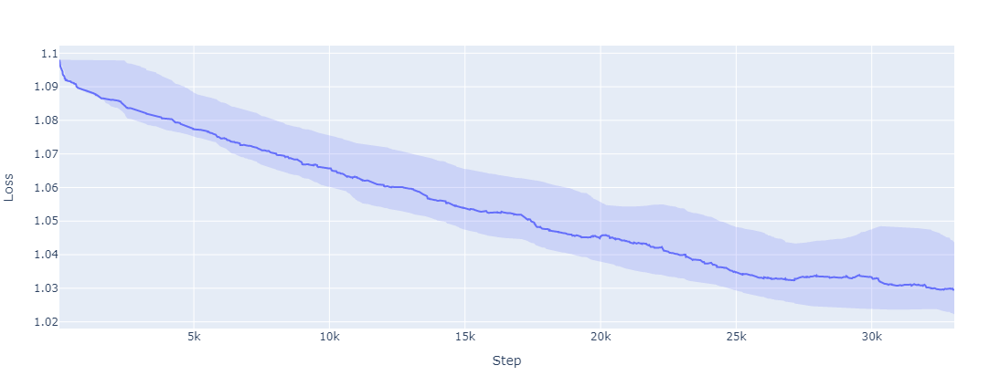

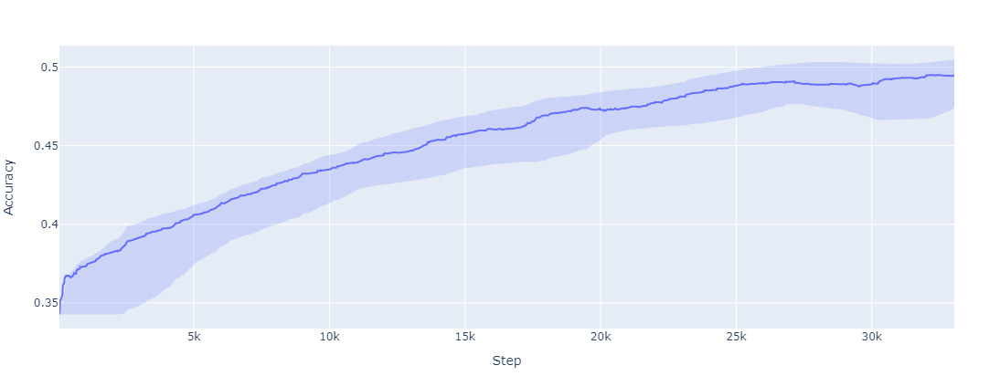

In [5]:
names = ['train_data/s2_train_loss', 'train_data/s2_train_accr']
ys = ['Loss', 'Accuracy']
for name, y in zip(names, ys):
    plot_and_save(name, y)

# S3(2) Training

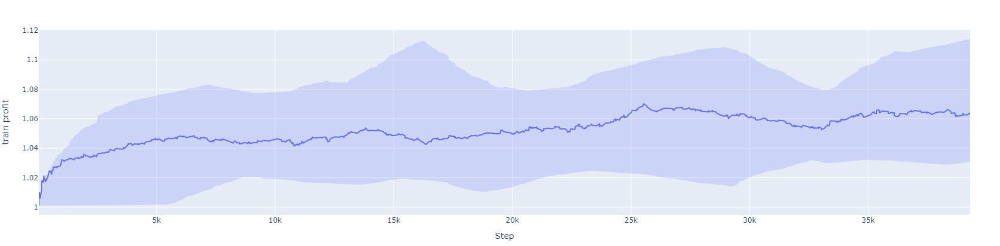

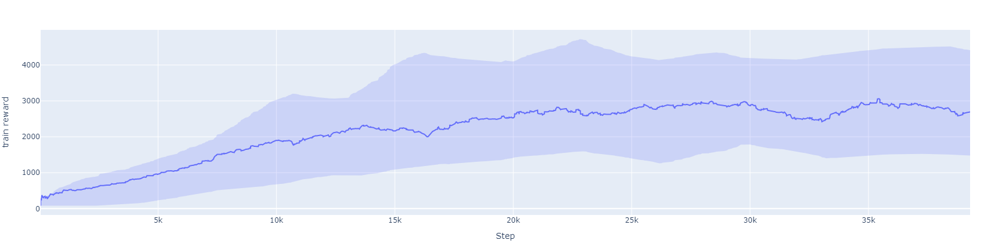

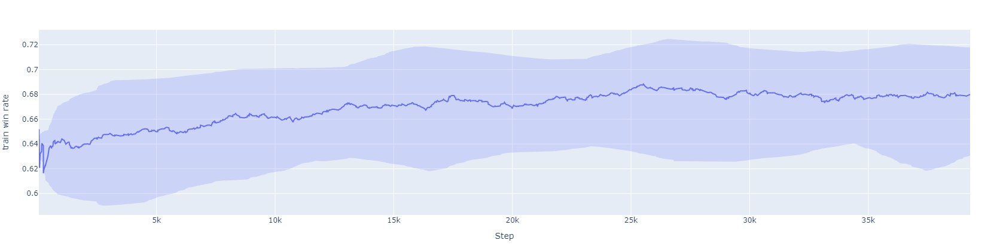

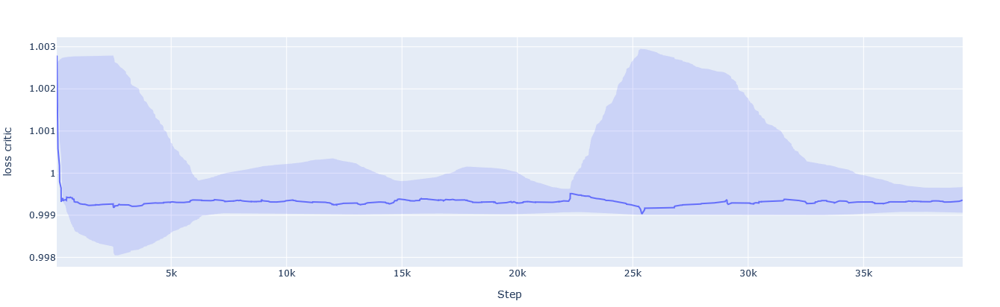

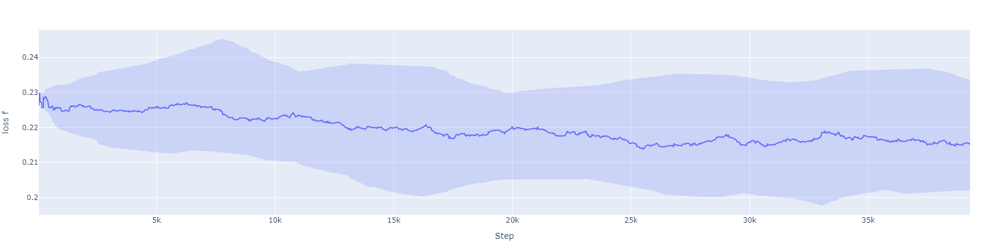

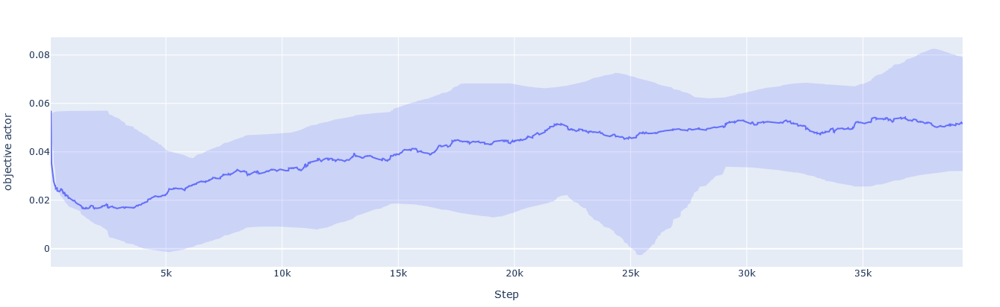

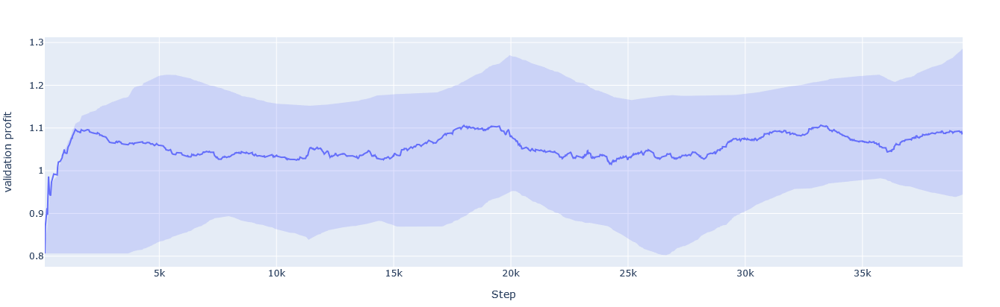

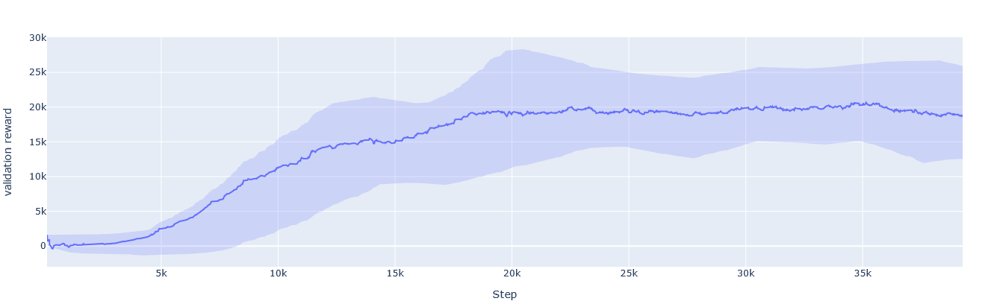

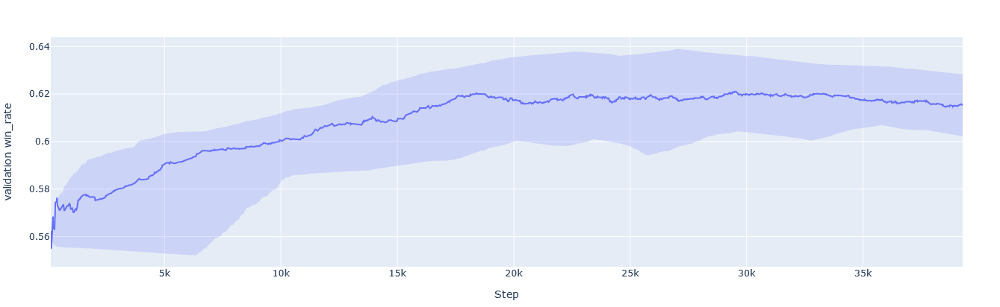

In [6]:
names = ['train_data/S3_Interaction_Money', 'train_data/S3_Interaction_Reward', 
         'train_data/S3_Interaction_win_rate', 'train_data/S3_Update_loss_critic', 
         'train_data/S3_Update_loss_f', 'train_data/S3_Update_objective_actor', 
         'train_data/S3_Validation_money', 'train_data/S3_Validation_reward',
         'train_data/S3_Validation_win_rate'
        ]
ys = ['train profit', 'train reward', 
         'train win rate', 'loss critic', 
         'loss f', 'objective actor',
         'validation profit', 'validation reward',
         'validation win_rate'
        ]
for name, y in zip(names, ys):
    plot_and_save(name, y)

# Data Demo

In [7]:
img_shape = (64, 128)
latent_num = 16
cnn_chanel_num = 16

In [8]:
data = pd.read_csv(f"data/M8888.XDCE_5m.csv")
stats = stockstats.StockDataFrame(data)

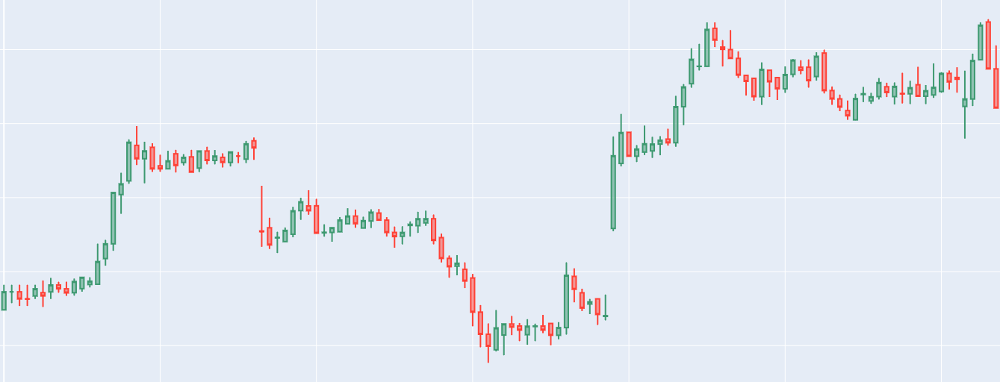

In [9]:
end = 2345
length = 128
fig = go.Figure(data=[go.Candlestick(
                open=data[end-length:end]['open'],
                high=data[end-length:end]['high'],
                low=data[end-length:end]['low'],
                close=data[end-length:end]['close'])])
fig.update_layout(width=1000, height=500, xaxis_rangeslider_visible=False, margin=dict(l=0, r=0, b=0, t=0))
fig.update_xaxes(showticklabels=False).update_yaxes(showticklabels=False)
fig.show()
fig.write_image('img/data_demo.pdf')

# Grey Scale Image Demo

In [10]:
def grey_scale_img(pos, alpha=1, uint=True):
    end = pos + 1
    C = img_shape[1]
    sta = end - C
    R = img_shape[0]
    # Ohlc
    op = list(stats[sta:end]['open'])
    clz = list(stats[sta:end]['close'])
    high = list(stats[sta:end]['high'])
    low = list(stats[sta:end]['low'])
    minn = min(low)
    base = max(high)-minn
    # compose image matrix
    a = np.zeros([R,C])
    for i in range(C):
        tmph = R - int(((high[i]-minn)*(R-1)/base)+0.5) - 1
        tmpl = R - int(((low[i]-minn)*(R-1)/base)+0.5)
        a[tmph:tmpl, i] = alpha
    if uint:
        a = np.uint8(a*255)
        return np.expand_dims(a, 2).repeat(3, 2)
    else:
        return np.expand_dims(a, 0)

In [11]:
pos_list = [1234, 2345, 3456, 4567, 5678]
for pos in pos_list:
    fig = px.imshow(grey_scale_img(pos))
    fig.update_layout(width=128, height=64, margin=dict(l=0, r=0, b=0, t=0))
    fig.update_xaxes(showticklabels=False).update_yaxes(showticklabels=False)
    fig.write_image(f'img/grey_scale_{pos}.jpg')

# Indicators Demo

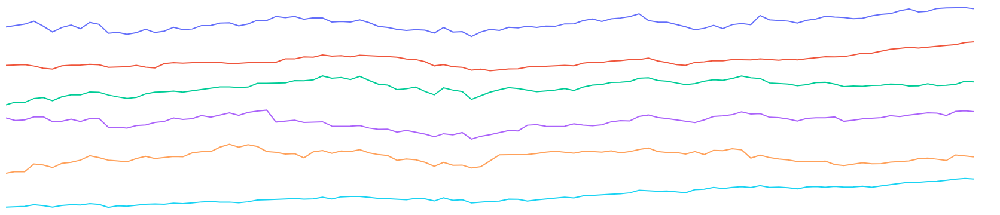

In [12]:
df = px.data.stocks(indexed=True)
fig = px.line(df, facet_row="company", facet_row_spacing=0.01, height=200, width=200)

# hide and lock down axes
fig.update_xaxes(visible=False, fixedrange=True)
fig.update_yaxes(visible=False, fixedrange=True)

# remove facet/subplot labels
fig.update_layout(annotations=[], overwrite=True)

# strip down the rest of the plot
fig.update_layout(
    showlegend=False,
    plot_bgcolor="white",
    margin=dict(t=10,l=10,b=10,r=10)
)

# disable the modebar for such a small plot
fig.show(config=dict(displayModeBar=False))

fig.write_image('img/indicator_demo.pdf')

# S3(2) Integrated Gradient

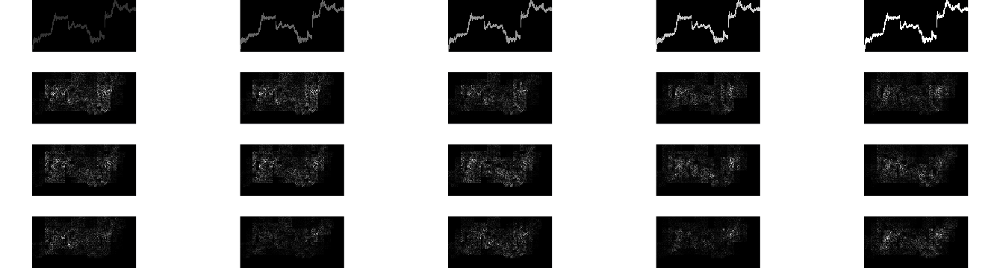

In [13]:
class AC(nn.Module):
    
    def __init__(self, latent_num, cnn_chanel_num, stat_dim):
        super(AC, self).__init__()
        
        # Encode
        self.encode_img = nn.Sequential(
            nn.Conv2d(1, cnn_chanel_num, 4, stride=2), nn.ReLU(), nn.MaxPool2d(3, stride=2),
            nn.Conv2d(cnn_chanel_num, 2*cnn_chanel_num, 4, stride=2), nn.ReLU(), nn.MaxPool2d(3, stride=2),
            nn.Conv2d(2*cnn_chanel_num, cnn_chanel_num, 1, stride=1), nn.ReLU(),
            nn.Flatten(),
            nn.Linear(192, latent_num), nn.ReLU())
        
        self.encode_stat = nn.Sequential(
            nn.Linear(stat_dim, latent_num), nn.ReLU(),
            nn.Linear(latent_num, latent_num), nn.ReLU())
        
        # Actor
        self.pi = nn.Sequential(
            nn.Linear(latent_num*2, latent_num), nn.ReLU(),
            nn.Linear(latent_num, latent_num//2), nn.ReLU())
        self.actor = nn.Sequential(
            nn.Linear(latent_num//2, 3), nn.Softmax(dim=-1))
        self.f = nn.Sequential(
            nn.Linear(latent_num//2, 1), nn.Sigmoid())
        
        # Critic
        self.V = nn.Sequential(
            nn.Linear(latent_num*2, latent_num), nn.ReLU(),
            nn.Linear(latent_num, latent_num//2), nn.ReLU(),
            nn.Linear(latent_num//2, 1))
    
    # Only used for visualization
    def forward(self, img, stat):
        encoded_img = self.encode_img(img)
        encoded_stat = self.encode_stat(stat)
        catted = torch.cat([encoded_img, encoded_stat], dim=1)
        hid = self.pi(catted)
        probs = self.actor(hid)
        f = self.f(hid)
        value = self.V(catted)
        return probs, f, value
    
ac = AC(16, 16, 7)

def gradient_img(img):
    img = torch.from_numpy(img).float().requires_grad_()
    probs = ac(img.unsqueeze(0), torch.zeros([1, 7]))[0].squeeze()
    grad_img = []
    for i in range(3):
        ac.zero_grad()
        probs[i].backward(retain_graph=True)
        grads = img.grad.squeeze().abs()
        grads = grads/grads.max()*255
        grads = grads.unsqueeze(2).expand(-1, -1, 3)
        grads = grads.numpy()
        grad_img.append(np.uint8(grads))
    return grad_img

cols = 5
fig = make_subplots(rows=4, cols=cols)
pos = 2333
for i in range(1,6):
    fig.add_trace(go.Image(z=grey_scale_img(pos, 1/cols*i)), 1, i)
    
    grad_img = gradient_img(grey_scale_img(pos, (1/cols*i)**5, uint=False))
    fig.add_trace(go.Image(z=grad_img[0]), 2, i)
    fig.add_trace(go.Image(z=grad_img[1]), 3, i)
    fig.add_trace(go.Image(z=grad_img[2]), 4, i)
fig.update_layout(width=128*5, height=64*4, margin=dict(l=0, r=0, b=0, t=0))
fig.update_xaxes(showticklabels=False).update_yaxes(showticklabels=False)
fig.show()

# Eval - Profit vs total-step

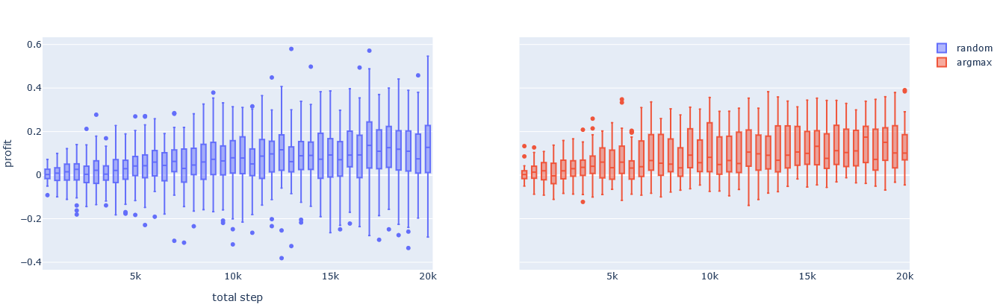

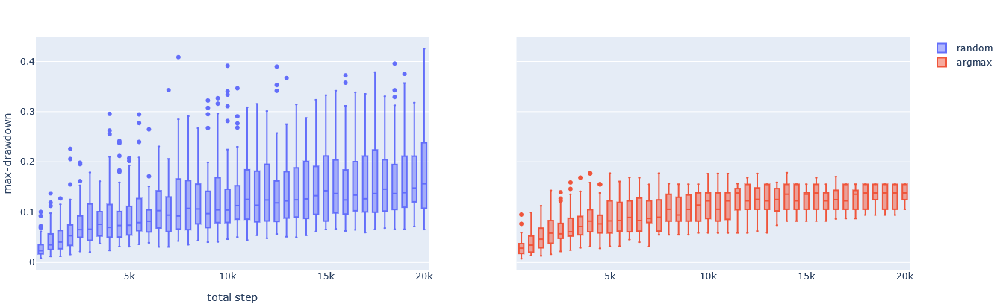

In [74]:
width = 1300
height = 400
margin = dict(l=0, r=10, b=50, t=50)

df1 = pd.read_csv('evaluate/draw-profit-vs-step.csv')

df2 = pd.read_csv('evaluate/draw-profit-vs-step-arg-max.csv')

def shit(df1, df2, y_title, name):
    from plotly.subplots import make_subplots
    fig = make_subplots(rows=1, cols=2, shared_yaxes=True)
    fig.add_trace(go.Box(x=df1["total_step"], y=df1[name], name='random'), row=1, col=1)
    fig.add_trace(go.Box(x=df2["total_step"], y=df2[name], name='argmax'), row=1, col=2)
    fig.update_layout(xaxis_title='total step', yaxis_title=y_title, margin=margin, width=width, height=height)
    fig.write_image(f'img/eval_{name}.pdf')
    fig.show()

shit(df1, df2, 'profit', 'profit')
shit(df1, df2, 'max-drawdown', 'max_drawdown')

# Total_Step vs Threshold

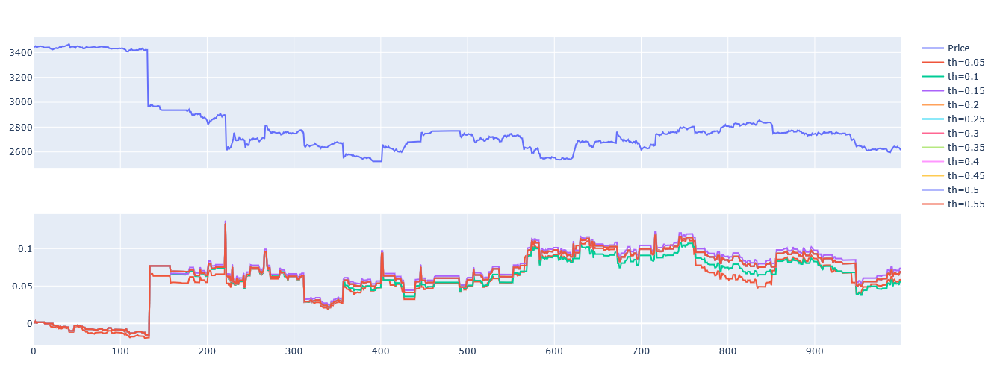

In [136]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=2, cols=1, shared_xaxes=True)
df1 = pd.read_csv('evaluate/threshold-price.csv')

fig.append_trace(go.Scatter(
    y = df1["price"],
    name = "Price",
), row=1, col=1)

def f(threshold):
    df2 = pd.read_csv(f'evaluate/threshold/threshold={threshold}.csv')
    fig.add_trace(go.Scatter(
        y = df2['profit'],
        name = f'th={threshold}',
    ), row=2, col=1)

for threshold in range(5,56,5):
    threshold /= 100
    f(threshold)

fig.update_layout(margin = dict(l=10, r=10, b=50, t=50), height=500, width=600)
fig.show()
fig.write_image("img/threshold.pdf")

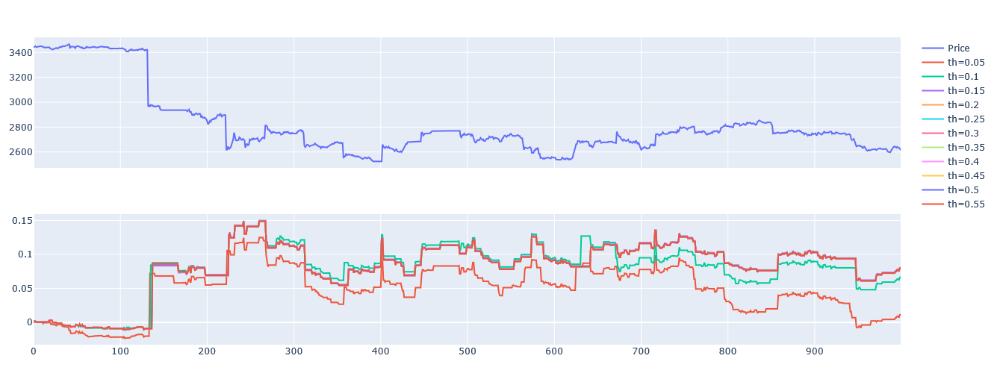

In [20]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=2, cols=1, shared_xaxes=True)
df1 = pd.read_csv('evaluate/threshold-price.csv')

fig.append_trace(go.Scatter(
    y = df1["price"],
    name = "Price",
), row=1, col=1)

def f(threshold):
    df2 = pd.read_csv(f'evaluate/threshold_max/threshold_max={threshold}.csv')
    fig.add_trace(go.Scatter(
        y = df2['profit'],
        name = f'th={threshold}',
    ), row=2, col=1)

for threshold in range(5,56,5):
    threshold /= 100
    f(threshold)

fig.update_layout(margin = dict(l=10, r=10, b=50, t=50), height=500, width=600)
fig.show()
fig.write_image("img/threshold_max.pdf")

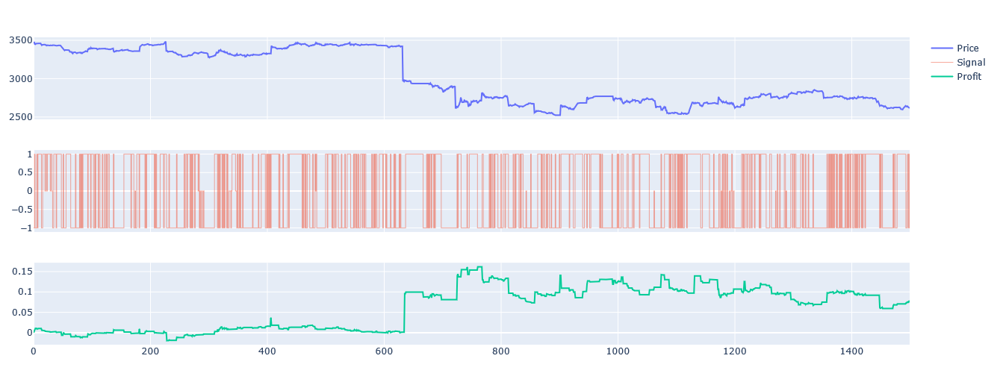

In [51]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=3, cols=1, shared_xaxes=True)
df1 = pd.read_csv('evaluate/price-profit＿max.csv')

fig.append_trace(go.Scatter(
    y = df1["prices"],
    name = "Price",
), row=1, col=1)

fig.append_trace(go.Scatter(
    y = df1["signal"],
    name = "Signal",
    line_shape='hvh',
    line = dict(width=0.5)
    # marker = dict(color = 'crimson', size = 0),
    # mode = 'markers',
), row=2, col=1)

fig.append_trace(go.Scatter(
    y = df1["profit"],
    name = "Profit",
), row=3, col=1)

fig.update_layout(margin = dict(l=10, r=10, b=50, t=50), height=500, width=1300)
fig.show()
fig.write_image("img/price-signal-profit_max.pdf")